In [1]:
from cluster import *

In [2]:
kpts_file = "keypoints.npz"

In [3]:
kpts = np.load(kpts_file)
# kpts = np.load("keypoints_globalrot.npz")
res = []
for ds_name in DS_NAMES:
    res.append(kpts[ds_name][:, :17])
data = np.concatenate(res).reshape(-1, 51)
data_clean = data[~np.isnan(data).any(axis=1)] 

In [4]:
from sklearn.preprocessing import normalize
data_clean = normalize(data_clean, norm='l2')

In [5]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from tqdm import tqdm

In [6]:
range_n_clusters = range(10,61,2)
inertias = []

for n_clusters in tqdm(range_n_clusters):
    # # Create a subplot with 1 row and 2 columns
    # fig, ax1 = plt.subplots(1, 1)
    # # fig.set_size_inches(18, 7)

    # # The 1st subplot is the silhouette plot
    # # The silhouette coefficient can range from -1, 1 but in this example all
    # # lie within [-0.1, 1]
    # ax1.set_xlim([-0.1, 1])
    # # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # # plots of individual clusters, to demarcate them clearly.
    # ax1.set_ylim([0, len(data) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(init="k-means++", n_clusters=n_clusters, n_init=4, random_state=10)
    cluster_labels = make_pipeline(StandardScaler(), clusterer).fit_predict(data_clean)
    inertias.append(clusterer.inertia_)

    # # The silhouette_score gives the average value for all the samples.
    # # This gives a perspective into the density and separation of the formed
    # # clusters
    # silhouette_avg = silhouette_score(data, cluster_labels)
    # print(
    #     "For n_clusters =",
    #     n_clusters,
    #     "The average silhouette_score is :",
    #     silhouette_avg,
    # )

    # # Compute the silhouette scores for each sample
    # sample_silhouette_values = silhouette_samples(data, cluster_labels)

    # y_lower = 10
    # for i in range(n_clusters):
    #     # Aggregate the silhouette scores for samples belonging to
    #     # cluster i, and sort them
    #     ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

    #     ith_cluster_silhouette_values.sort()

    #     size_cluster_i = ith_cluster_silhouette_values.shape[0]
    #     y_upper = y_lower + size_cluster_i

    #     color = cm.nipy_spectral(float(i) / n_clusters)
    #     ax1.fill_betweenx(
    #         np.arange(y_lower, y_upper),
    #         0,
    #         ith_cluster_silhouette_values,
    #         facecolor=color,
    #         edgecolor=color,
    #         alpha=0.7,
    #     )

    #     # Label the silhouette plots with their cluster numbers at the middle
    #     ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    #     # Compute the new y_lower for next plot
    #     y_lower = y_upper + 10  # 10 for the 0 samples

    # ax1.set_title("The silhouette plot for the various clusters.")
    # ax1.set_xlabel("The silhouette coefficient values")
    # ax1.set_ylabel("Cluster label")

    # # The vertical line for average silhouette score of all the values
    # ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    # ax1.set_yticks([])  # Clear the yaxis labels / ticks
    # ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # # # 2nd Plot showing the actual clusters formed
    # # colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    # # ax2.scatter(
    # #     X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    # # )

    # # # Labeling the clusters
    # # centers = clusterer.cluster_centers_
    # # # Draw white circles at cluster centers
    # # ax2.scatter(
    # #     centers[:, 0],
    # #     centers[:, 1],
    # #     marker="o",
    # #     c="white",
    # #     alpha=1,
    # #     s=200,
    # #     edgecolor="k",
    # # )

    # # for i, c in enumerate(centers):
    # #     ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    # # ax2.set_title("The visualization of the clustered data.")
    # # ax2.set_xlabel("Feature space for the 1st feature")
    # # ax2.set_ylabel("Feature space for the 2nd feature")

    # plt.suptitle(
    #     "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
    #     % n_clusters,
    #     fontsize=14,
    #     fontweight="bold",
    # )

# plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [22:42<00:00, 52.39s/it]


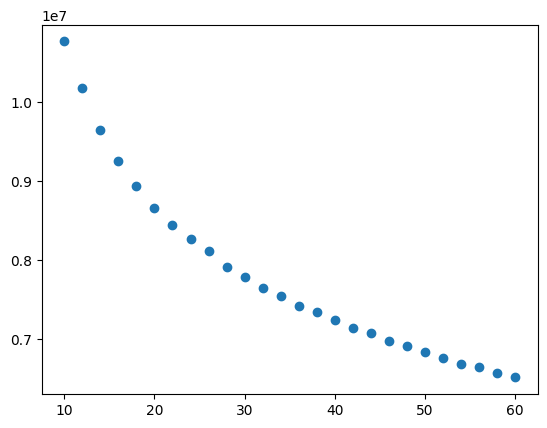

In [7]:
plt.scatter(range(10,61,2), inertias)

In [16]:
n_clusters = 25
clusterer = KMeans(init="k-means++", n_clusters=n_clusters, n_init=4, random_state=10)
cluster_labels = make_pipeline(StandardScaler(), clusterer).fit_predict(data_clean)

In [17]:
np.unique(cluster_labels, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24], dtype=int32),
 array([21355, 69747, 14458,  8136,  6729, 14535, 43535, 65786, 18836,
         9688,  1449, 42702,  1920,  8764, 38109,  2928, 24394,  7762,
        32273,  8288,  8193, 14568,  9180, 11464, 12759]))

Let's visualize the top and bottom 5 images of all clusters in terms of distance from its cluster mean

In [13]:
# grab image names
import config
import os.path as osp
imgnames = [np.load(config.DATASET_FILES[1][ds])['imgname'] if ds != "3dpw" else np.load(config.DATASET_FILES[0][ds])['imgname'] for ds in DS_NAMES]
lengths_list = [len(arr) for arr in imgnames]
ds_list = []
for (length, ds) in zip(lengths_list, DS_NAMES):
    ds_list.extend([ds] * length)
imgnames = np.concatenate(imgnames)
imgnames = imgnames[~np.isnan(data).any(axis=1)]
ds_list = np.array(ds_list)[~np.isnan(data).any(axis=1)]
img_dirs = []
for i, ds in enumerate(ds_list):
    img_dirs.append(osp.join(config.DATASET_FOLDERS[ds], imgnames[i]))

['/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/h36m/images/S1_Directions_1.54138969_000636.jpg'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/hr-lspet/im09355.png'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/hr-lspet/im09318.png'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/hr-lspet/im09302.png'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/hr-lspet/im09299.png'] ['/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/h36m/images/S7_Discussion.54138969_002331.jpg'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/h36m/images/S7_Discussion.54138969_002311.jpg'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/h36m/images/S7_Discussion.54138969_002261.jpg'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/h36m/images/S7_Discussion.54138969_002251.jpg'
 '/gpfs/milgram/scratch60/yildirim/hakan/datasets/SPIN_datasets/3dpw/imageFiles/outdoors_fencing_0

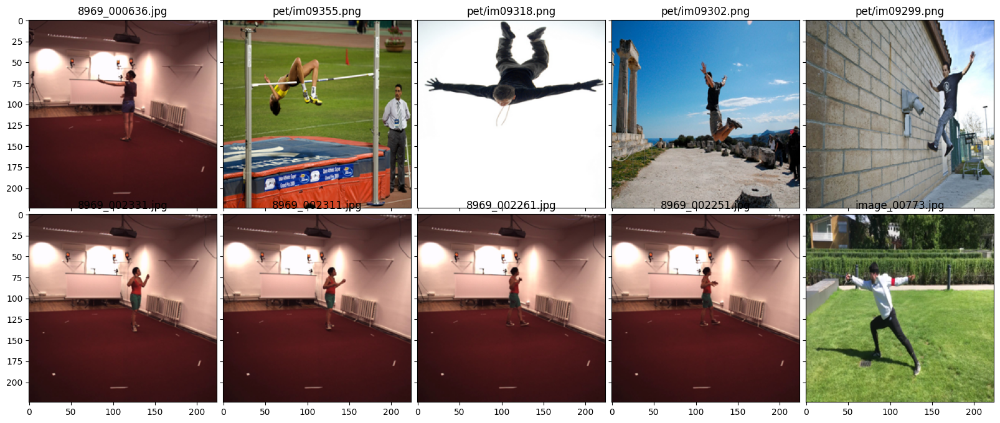

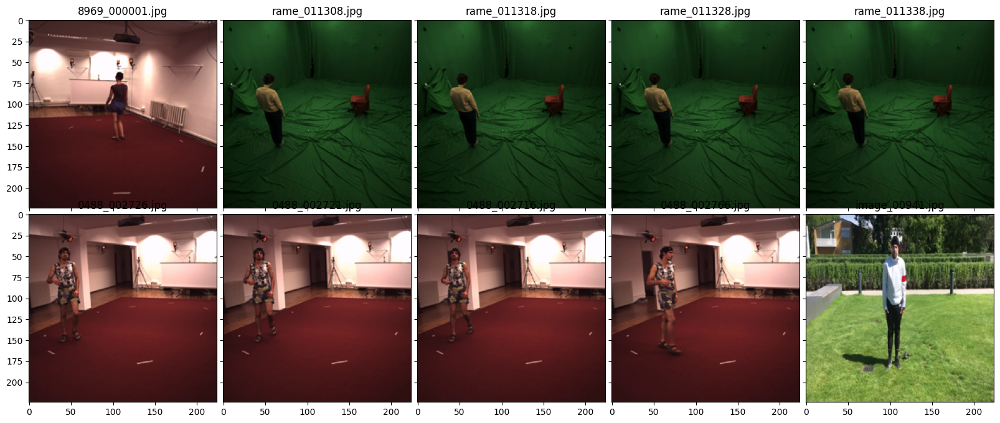

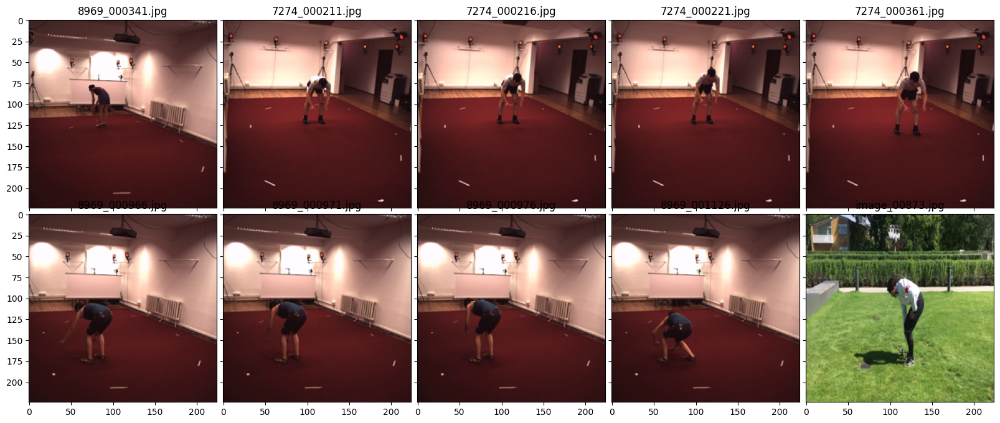

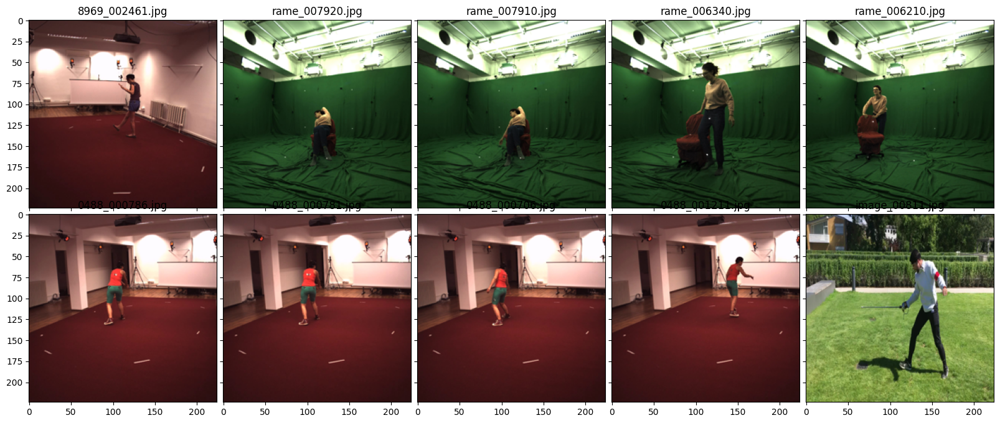

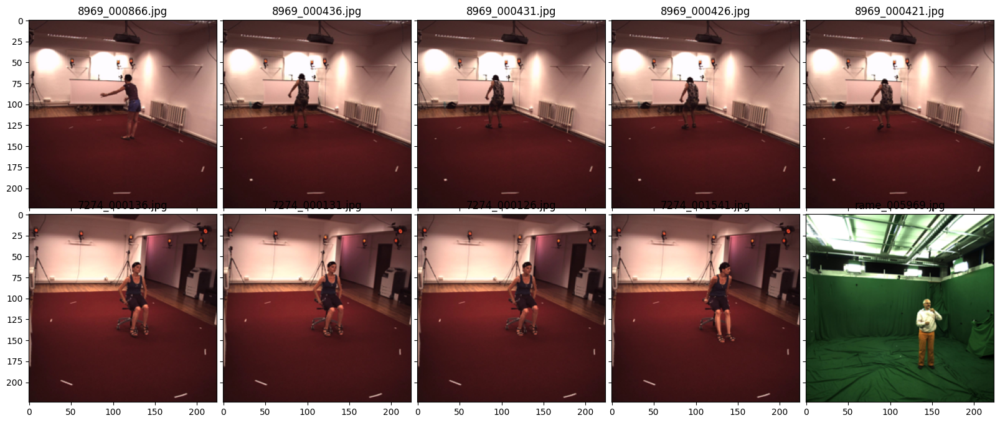

...

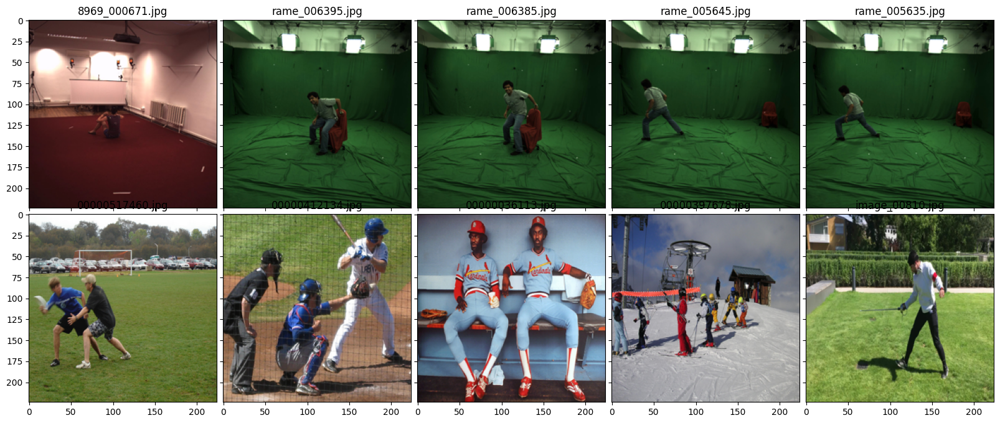

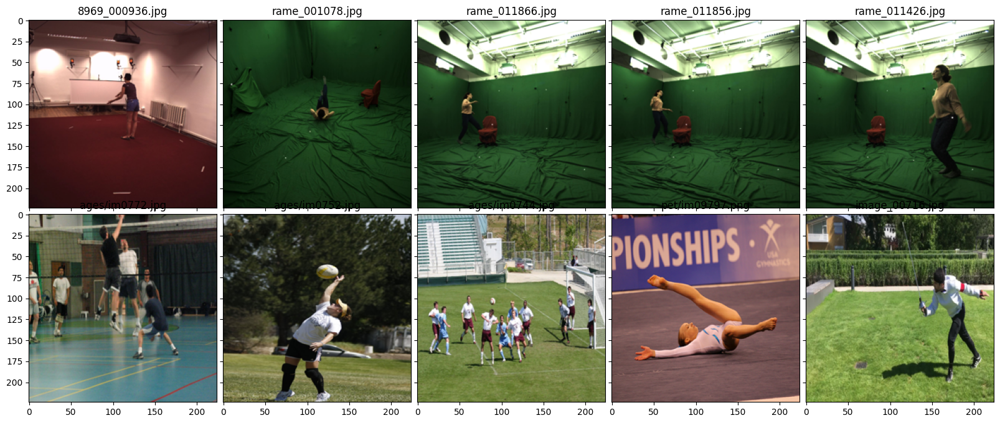

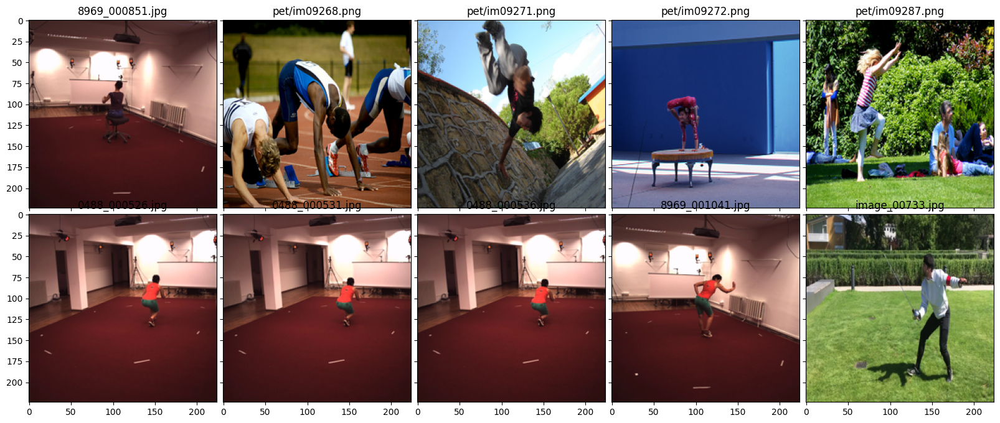

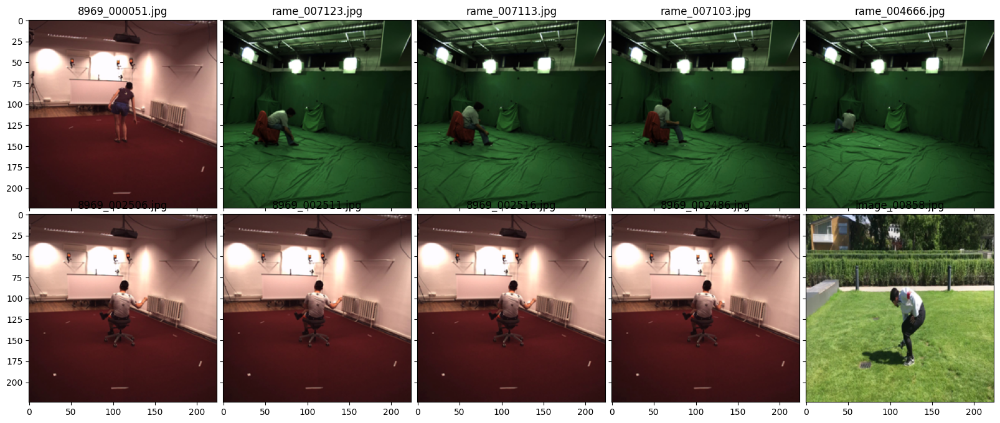

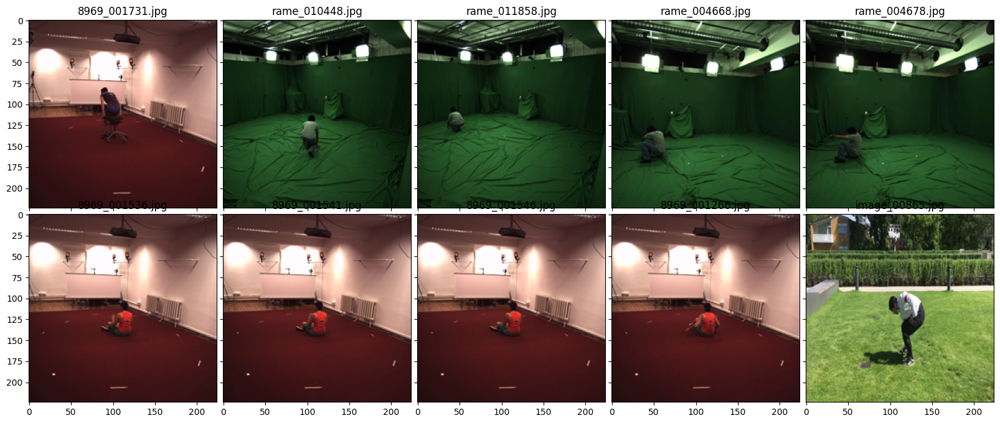

In [18]:
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.pyplot as plt
from PIL import Image

top_bottom_n = 5
for cluster in range(max(cluster_labels)):
    cluster_idcs = np.where(clusterer.labels_ == cluster)
    inertias_cluster = clusterer.labels_[cluster_idcs]
    imgdirs_cluster = np.array(img_dirs)[cluster_idcs]
    sort_idcs = np.argsort(inertias_cluster)
    top_5 = imgdirs_cluster[sort_idcs[:top_bottom_n]]
    bottom_5 = imgdirs_cluster[sort_idcs[-top_bottom_n:]]

    # for debugging purposes
    if cluster == 0: print(top_5, bottom_5)
        
    fig = plt.figure(figsize=(20,20))
    grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(2, top_bottom_n),  # creates 2x2 grid of Axes
                     axes_pad=0.1,  # pad between Axes in inch.
                     )
    top_bottom_dirs = np.concatenate((top_5, bottom_5))
    for i, ax in enumerate(grid):
        # Iterating over the grid returns the Axes.
        img = np.asarray(Image.open(top_bottom_dirs[i]).resize((224,224)))
        ax.imshow(img)
        ax.set_title(top_bottom_dirs[i][-15:])
    plt.show()

In [26]:
# partition the labels and store on a per-dataset basis
from collections import Counter
lengths_list = Counter(ds_list)
lengths_list = np.array([value for value in lengths_list.values()])
labels = np.split(clusterer.labels_, lengths_list.cumsum()[:-1])
labels_dict = dict(zip(DS_NAMES, labels))
labels_dict["n_classes"] = n_clusters
np.savez("data/labels.npz", **labels_dict)